# Description
 This notebooks looks for opportunities to detect home/ work locations in a month before covid using clustering approach

In [ ]:
import os
import tqdm
import warnings
import argparse
import dask.dataframe as dd
import dask_geopandas as dg
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point
import numpy as np
from geofunctions import utils

In [ ]:
# run if notebook restarted
df_filtered_good=pd.read_parquet(utils.get_path('raw','dwells',"data_filtered_202001.parquet"))
from shapely import wkb
df_filtered_good ['the_geom'] = df_filtered_good ['the_geom'].apply(wkb.loads)


In [3]:
df_filtered_dwells = gpd.GeoDataFrame(df_filtered_good , crs=4326, geometry='the_geom')

### Statistic

In [7]:
df_filtered_dwells.identifier.nunique()

56156

<Axes: >

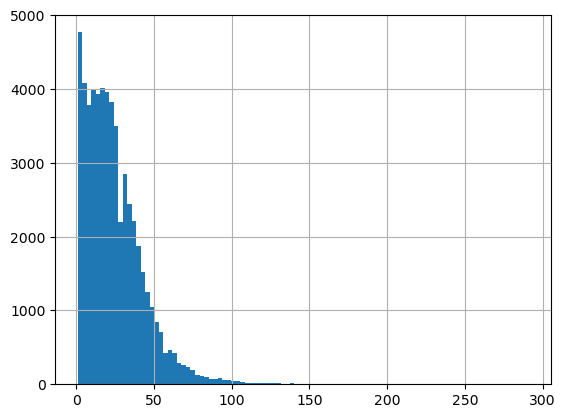

In [8]:
df_filtered_dwells.groupby("identifier")["geohash"].nunique().hist(bins=100)

<Axes: >

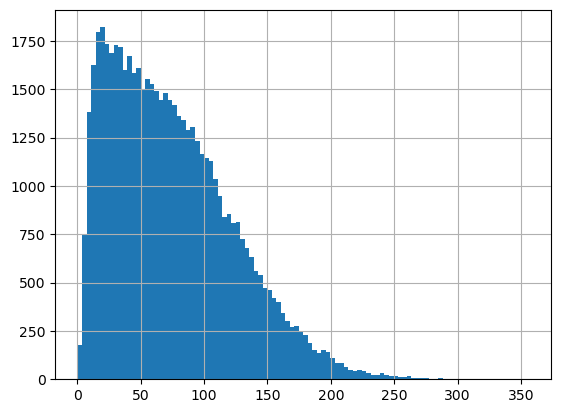

In [9]:
df_filtered_dwells.groupby("identifier")["duration_hours"].sum().hist(bins=100)

<Axes: >

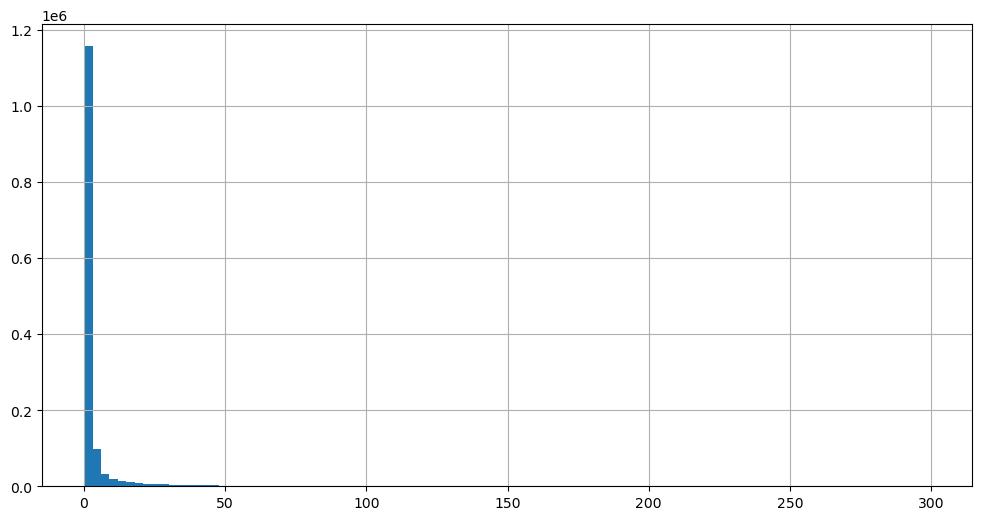

In [302]:
df_filtered_dwells.groupby(["identifier","geohash"])["duration_hours"].sum().hist(bins=100)

In [ ]:
df_filtered_dwellsdf_filtered_dwells["duration_hours"]>1].groupby(["identifier","geohash"])["duration_hours"].sum().hist(bins=100)

In [303]:
df_filtered_dwells[df_filtered_dwells["duration_hours"]>1].groupby(["identifier","geohash"])["duration_hours"].sum()

np.float64(6.720792077032089)

In [305]:
df_filtered_dwells["identifier"].nunique()

56156

<Axes: >

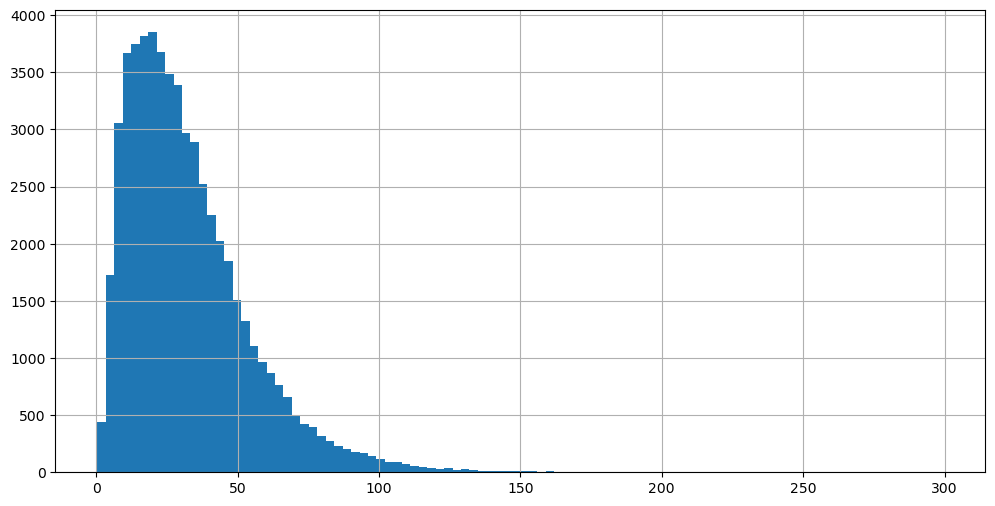

In [309]:
df_filtered_dwells.groupby(["identifier","geohash"])["duration_hours"].sum().groupby(level=0).max().hist(bins=100)

In [312]:
user_geohash_desc = df_filtered_dwells.groupby(["identifier","geohash"])["duration_hours"].sum().to_frame().join(
    df_filtered_dwells.groupby(["identifier","geohash"])["date"].nunique().to_frame())

In [320]:
user_geohash_desc["rank_frequency_day"] = user_geohash_desc.groupby(["identifier"])['date'].rank(ascending=False, method='first')

In [321]:
user_geohash_top = user_geohash_desc[user_geohash_desc["rank_frequency_day"]<=2]

<Axes: xlabel='duration_hours', ylabel='date'>

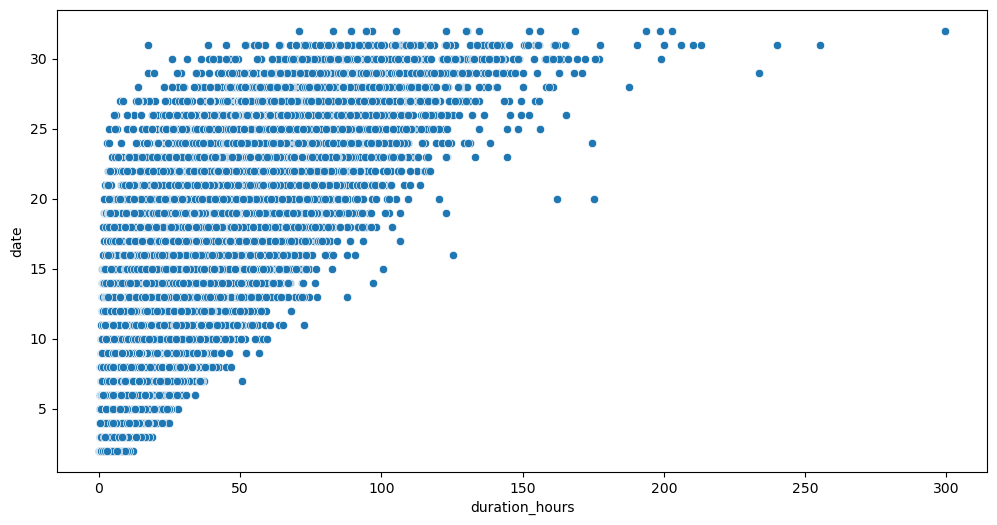

In [324]:
import seaborn as sn
sn.scatterplot(data = user_geohash_top[user_geohash_top["rank_frequency_day"]==1], x='duration_hours', y='date')

In [304]:
df_filtered_dwells[df_filtered_dwells["duration_hours"]>2]["identifier"].nunique()

56039

In [13]:
df_filtered_dwells[df_filtered_dwells.identifier=='010626e6-8d67-4c5a-8fbc-8b8948ba500a'].sort_values('local_date_time').to_csv("example_users_dwells.csv")

## For each geohash we add ratios of home and work based on signals distribution

#### Home

In [14]:
geohash_ident_share_night = df_filtered_dwells.groupby(["identifier","geohash"])["flag_night"].sum()/df_filtered_dwells.groupby(["identifier"])["flag_night"].sum()

geohash_ident_share_night = geohash_ident_share_night.rename("share_geohash_in_night_hours").to_frame()

In [15]:
geohash_ident_share_night = geohash_ident_share_night.join(
    (df_filtered_dwells.groupby(["identifier","geohash"])["flag_night"].sum()
    /df_filtered_dwells.groupby(["geohash"])["flag_night"].sum()).rename("share_night_hours_in_geohash")
)

In [63]:
geohash_ident_share_night = geohash_ident_share_night.join(
    (df_filtered_dwells[df_filtered_dwells["flag_night"]].groupby(["identifier","geohash"])["duration_hours"].sum()
    /df_filtered_dwells[df_filtered_dwells["flag_night"]].groupby(["geohash"])["duration_hours"].sum()).rename("share_night_hours_duration_in_geohash")
    , how='left'
)

geohash_ident_share_night = geohash_ident_share_night.join(
    (df_filtered_dwells[df_filtered_dwells["flag_night"]].groupby(["identifier","geohash"])["duration_hours"].sum()
    /df_filtered_dwells[df_filtered_dwells["flag_night"]].groupby(["identifier"])["duration_hours"].sum()).rename("share_geohash_duration_in_night_hours")
    , how='left'
)

array([[<Axes: title={'center': 'share_geohash_in_night_hours'}>,
        <Axes: title={'center': 'share_night_hours_in_geohash'}>],
       [<Axes: title={'center': 'rank'}>,
        <Axes: title={'center': 'share_night_hours_duration_in_geohash'}>],
       [<Axes: title={'center': 'share_geohash_duration_in_night_hours'}>,
        <Axes: >]], dtype=object)

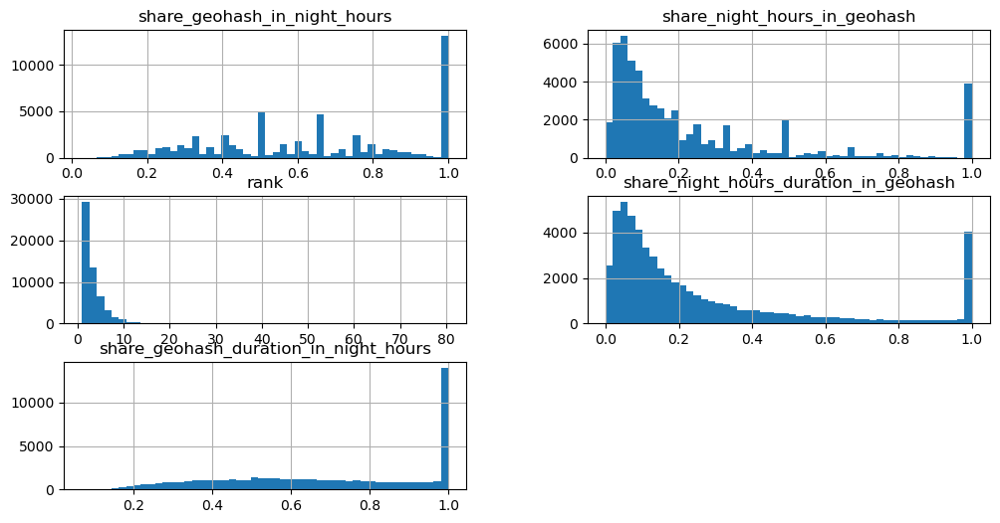

In [64]:
geohash_ident_share_night[geohash_ident_share_night["share_geohash_in_night_hours"]>0].groupby(level =0).max().hist(bins=50, figsize=(12,6))

we are confident at home location when it is higher than 70%

In [17]:
geohash_ident_share_night["rank"] = geohash_ident_share_night.groupby(level=0)["share_geohash_in_night_hours"].rank(ascending=False)

In [18]:
# geohash_ident_share_night.loc[(geohash_ident_share_night.flag_night>=0.7),"flag_home_location"] = 1

In [19]:
geohash_ident_share_night.loc[
    (geohash_ident_share_night["share_geohash_in_night_hours"] > 0) &
    (geohash_ident_share_night["share_geohash_in_night_hours"] < 0.7) &
    (geohash_ident_share_night["rank"] < 2)
].shape

(35986, 3)

In [20]:
geohash_ident_share_night[ (geohash_ident_share_night["rank"] < 2)].shape

(59045, 3)

In [21]:
print(f"{31514/59045*100} % of users have uncertain home location")

53.37285121517487 % of users have uncertain home location


### Work

In [103]:
geohash_ident_share_work = df_filtered_dwells.groupby(["identifier","geohash"])["flag_work_hours"].sum()/df_filtered_dwells.groupby(["identifier"])["flag_work_hours"].sum()

geohash_ident_share_work = geohash_ident_share_work.rename("share_geohash_in_work_hours").to_frame()

In [104]:
geohash_ident_share_work = geohash_ident_share_work.join(
    (df_filtered_dwells.groupby(["identifier","geohash"])["flag_work_hours"].sum()
    /df_filtered_dwells.groupby(["geohash"])["flag_work_hours"].sum()).rename("share_work_hours_in_geohash")
)

In [105]:
geohash_ident_share_work = geohash_ident_share_work.join(
    (df_filtered_dwells[df_filtered_dwells["flag_work_hours"]].groupby(["identifier","geohash"])["duration_hours"].sum()
    /df_filtered_dwells[df_filtered_dwells["flag_work_hours"]].groupby(["geohash"])["duration_hours"].sum()).rename("share_work_hours_duration_in_geohash")
    , how='left'
)

geohash_ident_share_work = geohash_ident_share_work.join(
    (df_filtered_dwells[df_filtered_dwells["flag_work_hours"]].groupby(["identifier","geohash"])["duration_hours"].sum()
    /df_filtered_dwells[df_filtered_dwells["flag_work_hours"]].groupby(["identifier"])["duration_hours"].sum()).rename("share_geohash_duration_in_work_hours")
    , how='left'
)

In [106]:
geohash_ident_share_work = geohash_ident_share_work.fillna(0)

Level of uncertainty is much higher than at home

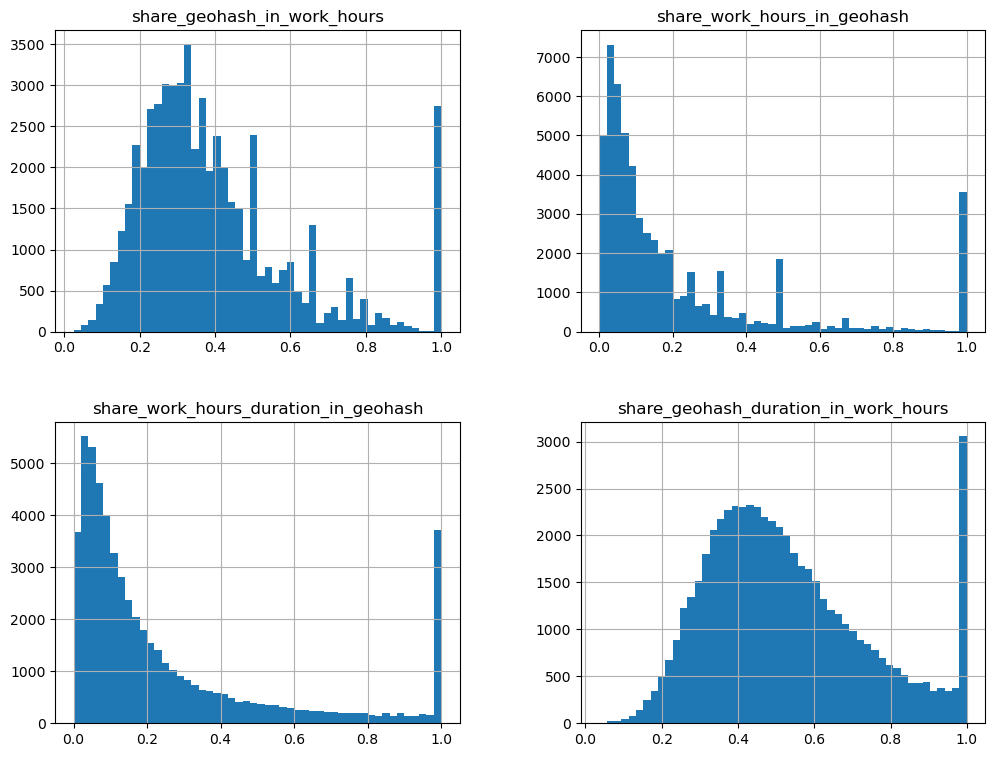

In [107]:

import matplotlib.pyplot as plt
ax = geohash_ident_share_work[geohash_ident_share_work.share_geohash_in_work_hours>0].groupby(level =0).max().hist(bins=50,figsize=(12,9))

In [30]:
geohash_ident_share_work[(geohash_ident_share_work.share_geohash_in_work_hours>0.3)]

,,share_geohash_in_work_hours,share_work_hours_in_geohash
identifier,geohash,,
00011a0e-9b5f-4de2-9d1e-147f2b85831e,swnvcgp,0.526316,0.075758
00065be3-e477-417b-b498-51b1e0154e6c,swnvcx9,0.588235,0.153846
0008481c-a961-48b2-a596-11d45ef53ad7,swntzgd,0.740741,0.123457
00092423-b349-4e52-bb3b-5a8cf9f35d37,swny36t,0.307692,0.006867
00092738-9ce5-45f7-b012-bdc70063e582,swnvcfv,0.521739,0.037267
...,...,...,...
fffa3cb1-de52-4823-a48f-e8bce83c5a18,swnysk8,0.340000,0.108974
fffc8d41-fb35-4d13-b708-60414aa5fa2a,swnv8kj,0.511628,0.217822
fffe150d-f747-4e4c-883b-efb11ceca235,swny5fj,0.333333,0.085714


In [59]:
df_filtered_dwells[(df_filtered_dwells.identifier=='0008481c-a961-48b2-a596-11d45ef53ad7')&(df_filtered_dwells.flag_work_hours)].explore(column='geohash')

In [61]:
df_filtered_dwells[(df_filtered_dwells.identifier=='0008481c-a961-48b2-a596-11d45ef53ad7')&(df_filtered_dwells.flag_night)]

,identifier,identifier_type,timestamp,local_date_time,province,classification,duration_seconds,centroid_latitude,centroid_longitude,bump_count,...,month,the_geom,frequency,duration_hours,geohash,date,start_date_time,end_date_time,flag_night,flag_work_hours
2305345,0008481c-a961-48b2-a596-11d45ef53ad7,GAID,2020-01-24 04:47:00,2020-01-24 06:47:00,HaMerkaz,AREA_DWELL,10702.0,31.983032,34.792261,5,...,1,POINT (34.79226 31.98303),101,2.972778,swntzv9,2020-01-24,2020-01-24 06:47:00,2020-01-24 09:45:22,True,False
6389937,0008481c-a961-48b2-a596-11d45ef53ad7,GAID,2020-01-20 19:43:10,2020-01-20 21:43:10,HaMerkaz,AREA_DWELL,2986.0,31.985133,34.780374,5,...,1,POINT (34.78037 31.98513),101,0.829444,swntzgd,2020-01-20,2020-01-20 21:43:10,2020-01-20 22:32:56,True,False
12504329,0008481c-a961-48b2-a596-11d45ef53ad7,GAID,2020-01-12 04:40:04,2020-01-12 06:40:04,HaMerkaz,AREA_DWELL,8885.0,31.982908,34.792007,10,...,1,POINT (34.79201 31.98291),101,2.468056,swntzv9,2020-01-12,2020-01-12 06:40:04,2020-01-12 09:08:09,True,True


In [62]:
df_filtered_dwells[(df_filtered_dwells.identifier=='0008481c-a961-48b2-a596-11d45ef53ad7')&(df_filtered_dwells.flag_night)].explore(column='geohash'
                                                                                                                                    , tiles='CartoDB positron')

In [67]:
geohash_ident_share_work["rank"] = geohash_ident_share_work.groupby(level=0)["share_geohash_duration_in_work_hours"].rank(ascending=False)

In [70]:
s1 = geohash_ident_share_work.loc[
    (geohash_ident_share_work["share_geohash_duration_in_work_hours"] > 0) &
    (geohash_ident_share_work["share_geohash_duration_in_work_hours"] < 0.7) &
    (geohash_ident_share_work["rank"] < 2)
].shape[0]

In [71]:
s2 = geohash_ident_share_work[ (geohash_ident_share_work["rank"] < 2)].shape[0]

In [72]:
print(f"{s1/s2*100} % of users have uncertain work location")

79.96117957119453 % of users have uncertain work location


In [79]:
df_filtered_dwells.loc[(df_filtered_dwells.identifier==
"0000be11-1c2a-4833-8f5e-d49f25b5fde9")
].explore( tiles="CartoDB positron", column = "flag_night", cmap='Set1')

### Add statistical area

Test easiest way: at what degree we reduce uncertainty by aggregating by neighborhood

In [ ]:
stat_areas = gpd.read_file(utils.get_path('processed','adm',"census_areas_gushdan.geojson"))

In [40]:
stat_areas=stat_areas.to_crs(4326)

In [41]:
stat_areas = stat_areas[stat_areas.intersects(boundaries)]

In [412]:
stat_areas.explore()

In [417]:
stat_areas.describe()

,OBJECTID,SEMEL_YISHUV,YISHUV_STAT_2022,STAT_2022,Stat2022_Ref,Main_Function_Code,ROVA,TAT_ROVA,Religion_Stat_Code,pop_approx,...,hh18_24_pcnt,hh_MidatDatiyut,Computer_avg,Vehicle0_pcnt,Vehicle2up_pcnt,Parking_pcnt,own_pcnt,rent_pcnt,Shape_Length,Shape_Area
count,1461.000000,1461.000000,1.461000e+03,1434.000000,96.000000,1421.000000,797.000000,1049.000000,1232.000000,1232.000000,...,1231.000000,1232.000000,1232.000000,1226.000000,1230.000000,1232.000000,1232.000000,1231.000000,1461.000000,1.461000e+03
mean,2195.145791,4972.488706,4.843066e+07,265.089261,323.385417,1.391977,4.464241,35.835081,1.074675,3132.508117,...,19.833956,1.409903,1.534497,22.519984,35.745041,66.101705,56.149269,34.938343,5283.408667,1.765490e+06
std,1055.975979,3034.604730,3.080900e+07,337.517757,341.122524,1.124838,3.357327,34.823416,0.464088,1628.378448,...,8.132418,0.848375,0.484264,16.966198,19.785615,25.616438,16.232793,15.173857,19571.621937,1.493043e+07
min,9.000000,22.000000,5.508000e+03,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,120.000000,...,1.800000,1.000000,0.300000,0.700000,0.300000,5.500000,0.600000,2.400000,340.773615,3.812854e+03
25%,1438.000000,1755.000000,1.309002e+07,8.000000,32.000000,1.000000,2.000000,11.000000,1.000000,1925.000000,...,14.100000,1.000000,1.200000,8.900000,18.000000,46.300000,47.375000,24.950000,1922.501447,1.823739e+05
50%,2640.000000,6100.000000,6.100012e+07,121.000000,224.500000,1.000000,4.000000,24.000000,1.000000,3115.000000,...,18.600000,1.000000,1.500000,18.300000,34.300000,71.850000,58.150000,33.000000,2713.094872,3.269702e+05
75%,3084.000000,7400.000000,7.400053e+07,421.750000,622.000000,1.000000,6.000000,52.000000,1.000000,4180.000000,...,24.100000,1.000000,1.900000,32.875000,52.100000,88.425000,67.900000,41.850000,4337.350632,7.317193e+05
max,3730.000000,9970.000000,9.800000e+07,1526.000000,1425.000000,6.000000,15.000000,152.000000,6.000000,11070.000000,...,52.300000,4.000000,3.100000,87.700000,89.400000,100.000000,90.200000,92.100000,423219.690663,4.378587e+08


In [421]:
stat_areas["YISHUV_STAT_2022"].value_counts()

YISHUV_STAT_2022
220001      1
64000234    1
64000232    1
64000231    1
64000224    1
           ..
86000414    1
13240001    1
13190001    1
13180001    1
9970        1
Name: count, Length: 1461, dtype: int64

In [44]:
df_filtered_dwells.columns

Index(['identifier', 'identifier_type', 'timestamp', 'local_date_time',
       'province', 'classification', 'duration_seconds', 'centroid_latitude',
       'centroid_longitude', 'bump_count', 'potential_start_time',
       'potential_end_time', 'month', 'the_geom', 'frequency',
       'long_3precision', 'lat_3precision', 'date', 'flag_night',
       'flag_weekday_day', 'geohash', 'start_date_time', 'end_date_time',
       'hour', 'potenital_duration_seconds', 'flag_work_hours',
       'duration_hours'],
      dtype='object')

In [54]:
df_filtered_dwells_stat = df_filtered_dwells.sjoin(stat_areas[["YISHUV_STAT_2022","OBJECTID","geometry"]], how='inner', predicate = 'within')

In [480]:
df_filtered_dwells.shape

(2407501, 27)

In [479]:
df_filtered_dwells_stat.shape

(2407263, 30)

#### Unique pair stat area - geohash - doesnt work so we can skip

In [877]:
df_geohash = df_filtered_dwells[["geohash"]].drop_duplicates()

In [878]:
df_geohash["geometry"]= df_geohash["geohash"].apply(lambda x: Point(pygeohash.decode(x)))

In [879]:
df_geohash_stat = gpd.GeoDataFrame(df_geohash, crs=4326, geometry="geometry").sjoin(stat_areas[["YISHUV_STAT_2022","OBJECTID","geometry"]], how='inner', predicate = 'within')

In [880]:
df_geohash_stat["YISHUV_STAT_2022"].nunique()

627

In [860]:
geohash_identifier_stat.merge(df_geohash_stat, on="geohash", how='inner')["YISHUV_STAT_2022"].nunique()

603

## Repeat by stat area

In [481]:
df_filtered_dwells_stat.head()

,identifier,identifier_type,timestamp,local_date_time,province,classification,duration_seconds,centroid_latitude,centroid_longitude,bump_count,...,geohash,start_date_time,end_date_time,hour,potenital_duration_seconds,flag_work_hours,duration_hours,index_right,YISHUV_STAT_2022,OBJECTID
1,6c3f05ea-3fcc-4016-b75e-236dd3abf244,GAID,2021-01-30 12:04:53,2021-01-30 14:04:53,HaMerkaz,AREA_DWELL,4689.0,32.100707,34.951923,99,...,swnyf6z,2021-01-30 14:04:53,2021-01-30 15:23:02,14,4710.0,False,1.302500,2132,26400033,2133
2,eb31c014-47ac-430e-bf55-a64eb1b6554f,GAID,2021-01-19 12:11:50,2021-01-19 14:11:50,Tel Aviv,AREA_DWELL,1068.0,32.101577,34.827152,18,...,swny4kp,2021-01-19 14:11:50,2021-01-19 14:29:38,14,5674.0,True,0.296667,3465,86000111,3466
8,91176a1b-019d-4e8a-ba85-3ad06e99d8cb,GAID,2021-01-20 15:21:42,2021-01-20 17:21:42,HaMerkaz,AREA_DWELL,227.0,31.974895,34.752191,19,...,swntxw7,2021-01-20 17:21:42,2021-01-20 17:25:29,17,3314.0,True,0.063056,3381,83000642,3382
9,fa588144-b838-40aa-9c73-cbfb3d9e1be4,GAID,2021-01-20 10:47:18,2021-01-20 12:47:18,Tel Aviv,AREA_DWELL,1321.0,32.128775,34.853511,27,...,swny70g,2021-01-20 12:47:18,2021-01-20 13:09:19,12,30925.0,True,0.366944,2149,26500016,2150
14,e560f8d6-6038-41eb-80db-8297bc4ecb88,GAID,2021-01-31 09:21:11,2021-01-31 11:21:11,HaMerkaz,AREA_DWELL,11784.0,32.321927,34.859425,53,...,swnyr9b,2021-01-31 11:21:11,2021-01-31 14:37:35,11,55246.0,False,3.273333,3214,74000333,3215


In [552]:
statarea_ident_share_night = df_filtered_dwells_stat.groupby(["identifier","YISHUV_STAT_2022"])["flag_night"].sum()/df_filtered_dwells.groupby(["identifier"])["flag_night"].sum()

Text(0.5, 1.0, 'Share of max bumber night signals distribution by user')

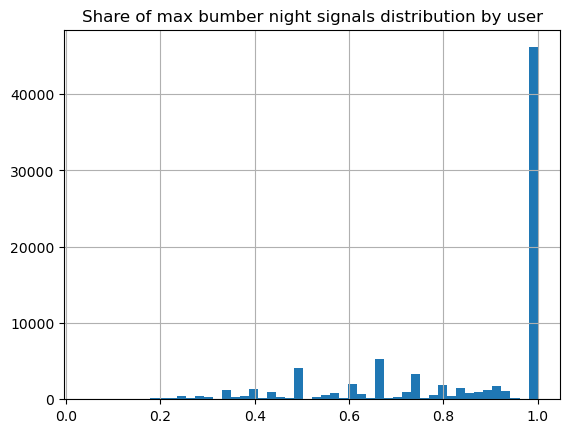

In [543]:
statarea_ident_share_night[statarea_ident_share_night>0].groupby(level =0).max().hist(bins=50)
plt.title("Share of max number of night signals distribution by user")

we are confident at home location when it is higher than 70%

In [544]:
statarea_ident_share_night = statarea_ident_share_night.to_frame()

In [545]:
statarea_ident_share_night = statarea_ident_share_night.rename(columns = {"flag_night":"share_night_dwells"})

In [548]:
statarea_ident_share_night["rank"] = statarea_ident_share_night.groupby(level=0)["share_night_dwells"].rank(ascending=False)

In [550]:
statarea_ident_share_night.loc[(statarea_ident_share_night.share_night_dwells>=0.7),"flag_home_location"] = 1

In [551]:
statarea_ident_share_night.loc[
    (statarea_ident_share_night["share_night_dwells"] > 0) &
    (statarea_ident_share_night["share_night_dwells"] < 0.7) &
    (statarea_ident_share_night["rank"] < 2)
].shape

(23338, 3)

In [494]:
statarea_ident_share_night[ (statarea_ident_share_night["rank"] < 2)].shape

(84722, 3)

In [495]:
23338/85226

0.2738366226268979

Decreased by 10% but not enough yet

In [504]:
statarea_ident_share_night.loc[
    (statarea_ident_share_night["flag_night"] > 0) &
    (statarea_ident_share_night["flag_night"] < 0.7) &
    (statarea_ident_share_night["rank"] < 2)
]

flag_night  rank  \
identifier                           YISHUV_STAT_2022                     
000e7523-9f12-44c5-bd8a-1c8052df8644 2290004             0.571429   1.0   
0015c0d0-d5a0-4199-bccb-23c21e9a2a45 62000223            0.666667   1.0   
001717a3-e237-4d90-aeff-67b5368acacc 13090012            0.666667   1.0   
0018b3eb-330e-489e-bed6-df992d31200a 62000513            0.400000   1.5   
                                     62000523            0.400000   1.5   
...                                                           ...   ...   
ffeebee8-460d-4dba-9b8c-d0598ddfacb7 85000015            0.444444   1.0   
ffeed5d8-c1c0-4798-80ea-990920c9f13d 61000522            0.272727   1.0   
ffef7f7c-68e2-4809-baeb-7b11de43a426 97000011            0.571429   1.0   
fff6e040-0c57-4b10-8229-a0d4532d8e44 50001014            0.500000   1.0   
fff9e117-8ea3-47cb-9d25-e34beb77c67d 62000321            0.600000   1.0   

                                                       flag_home_location  \
identifier                           YISHUV_STAT_2022                       
000e7523-9f12-44c5-bd8a-1c8052df8644 2290004                          NaN   
0015c0d0-d5a0-4199-bccb-23c21e9a2a45 62000223                         NaN   
001717a3-e237-4d90-aeff-67b5368acacc 13090012                         NaN   
0018b3eb-330e-489e-bed6-df992d31200a 62000513                         NaN   
                                     62000523                         NaN   
...                                                                   ...   
ffeebee8-460d-4dba-9b8c-d0598ddfacb7 85000015                         NaN   
ffeed5d8-c1c0-4798-80ea-990920c9f13d 61000522                         NaN   
ffef7f7c-68e2-4809-baeb-7b11de43a426 97000011                         NaN   
fff6e040-0c57-4b10-8229-a0d4532d8e44 50001014                         NaN   
fff9e117-8ea3-47cb-9d25-e34beb77c67d 62000321                         NaN   

                                                       count_night_dwells  
identifier                           YISHUV_STAT_2022                      
000e7523-9f12-44c5-bd8a-1c8052df8644 2290004                            4  
0015c0d0-d5a0-4199-bccb-23c21e9a2a45 62000223                           4  
001717a3-e237-4d90-aeff-67b5368acacc 13090012                           4  
0018b3eb-330e-489e-bed6-df992d31200a 62000513                           2  
                                     62000523                           2  
...                                                                   ...  
ffeebee8-460d-4dba-9b8c-d0598ddfacb7 85000015                           4  
ffeed5d8-c1c0-4798-80ea-990920c9f13d 61000522                           3  
ffef7f7c-68e2-4809-baeb-7b11de43a426 97000011                           4  
fff6e040-0c57-4b10-8229-a0d4532d8e44 50001014                           3  
fff9e117-8ea3-47cb-9d25-e34beb77c67d 62000321                           6  

[23338 rows x 4 columns]

In [850]:
statarea_ident_share_night.reset_index()["YISHUV_STAT_2022"].nunique()

1404

In [497]:
df_filtered_dwells_stat.loc[df_filtered_dwells_stat.identifier==
"000e7523-9f12-44c5-bd8a-1c8052df8644"
].explore( tiles="CartoDB positron", column = "flag_night", cmap='Set1')

### It doesnt help. So we add more factors but to geohashes

In [498]:
df_filtered_dwells.loc[df_filtered_dwells.identifier==
"0015c0d0-d5a0-4199-bccb-23c21e9a2a45"
].explore( tiles="CartoDB positron", column = "flag_night", cmap='Set1')

## Adding more factors to night

In [93]:
# number night 
geohash_ident_share_night = geohash_ident_share_night.join(
    df_filtered_dwells.groupby(["identifier"
                                     ,"geohash"]
                                   )["flag_night"].sum().rename("count_night_dwells")
)

In [94]:
geohash_ident_share_night = geohash_ident_share_night.join(
    df_filtered_dwells[df_filtered_dwells["flag_night"]==1].groupby(["identifier"
                                     ,"geohash"]
                                   )["duration_seconds"].sum()
)

In [95]:
geohash_ident_share_night.columns

Index(['share_geohash_in_night_hours', 'share_night_hours_in_geohash', 'rank',
       'share_night_hours_duration_in_geohash',
       'share_geohash_duration_in_night_hours', 'count_night_dwells',
       'duration_seconds'],
      dtype='object')

In [96]:
geohash_ident_share_night["duration_seconds"] = geohash_ident_share_night["duration_seconds"].fillna(0)

In [97]:
geohash_ident_share_night.head()

share_geohash_in_night_hours  \
identifier                           geohash                                 
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                           0.0   
                                     swnv9r7                           0.0   
                                     swny124                           0.0   
                                     swny13e                           0.0   
                                     swny13x                           0.0   

                                              share_night_hours_in_geohash  \
identifier                           geohash                                 
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                           0.0   
                                     swnv9r7                           0.0   
                                     swny124                           0.0   
                                     swny13e                           0.0   
                                     swny13x                           0.0   

                                              rank  \
identifier                           geohash         
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f  11.5   
                                     swnv9r7  11.5   
                                     swny124  11.5   
                                     swny13e  11.5   
                                     swny13x  11.5   

                                              share_night_hours_duration_in_geohash  \
identifier                           geohash                                          
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                                    NaN   
                                     swnv9r7                                    NaN   
                                     swny124                                    NaN   
                                     swny13e                                    NaN   
                                     swny13x                                    NaN   

                                              share_geohash_duration_in_night_hours  \
identifier                           geohash                                          
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                                    NaN   
                                     swnv9r7                                    NaN   
                                     swny124                                    NaN   
                                     swny13e                                    NaN   
                                     swny13x                                    NaN   

                                              count_night_dwells  \
identifier                           geohash                       
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                   0   
                                     swnv9r7                   0   
                                     swny124                   0   
                                     swny13e                   0   
                                     swny13x                   0   

                                              duration_seconds  
identifier                           geohash                    
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f               0.0  
                                     swnv9r7               0.0  
                                     swny124               0.0  
                                     swny13e               0.0  
                                     swny13x               0.0

In [99]:
# total dwells and duration
geohash_ident_share_night = geohash_ident_share_night.join(
    df_filtered_dwells.groupby(["identifier"
                                     ,"geohash"]
                                   )["duration_seconds"].agg(["count","sum"]).rename(
    columns={"count": "total_count_dwells", "sum": "total_duration_seconds"}
    )
                    , how='left'
)

In [100]:
geohash_identifier_stat = geohash_ident_share_night.join(
    df_filtered_dwells.groupby(["identifier"
                                     ,"geohash"]
                                   )["date"].nunique().rename("count_days")
                    , how='left'
)

In [101]:
geohash_identifier_stat = geohash_identifier_stat.join((df_filtered_dwells.groupby(["identifier","geohash"])["duration_seconds"].count()/
    df_filtered_dwells.groupby(["identifier"]) ["duration_seconds"].count()
).rename("share_dwells"))

In [102]:
geohash_identifier_stat = geohash_identifier_stat.rename( {"flag_night":"share_night_dwells", "duration_seconds":"night_duration_seconds"})

## Adding more factors to Work

In [108]:
# number night 
geohash_ident_share_work = geohash_ident_share_work.join( 
    df_filtered_dwells.groupby(["identifier"
                                     ,"geohash"]
                                   )["flag_work_hours"].sum().rename("count_work_dwells")
)

In [110]:
geohash_ident_share_work = geohash_ident_share_work.join(
    df_filtered_dwells[df_filtered_dwells["flag_work_hours"]==1].groupby(["identifier"
                                     ,"geohash"]
                                   )["duration_seconds"].sum()
)

In [112]:
geohash_ident_share_work["duration_seconds"] = geohash_ident_share_work["duration_seconds"].fillna(0)

In [113]:
geohash_ident_share_work.head()

share_geohash_in_work_hours  \
identifier                           geohash                                
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                     0.041667   
                                     swnv9r7                     0.041667   
                                     swny124                     0.041667   
                                     swny13e                     0.041667   
                                     swny13x                     0.166667   

                                              share_work_hours_in_geohash  \
identifier                           geohash                                
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                     0.001119   
                                     swnv9r7                     0.005780   
                                     swny124                     0.062500   
                                     swny13e                     0.010989   
                                     swny13x                     0.041237   

                                              share_work_hours_duration_in_geohash  \
identifier                           geohash                                         
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                              0.001954   
                                     swnv9r7                              0.002561   
                                     swny124                              0.105212   
                                     swny13e                              0.007147   
                                     swny13x                              0.052678   

                                              share_geohash_duration_in_work_hours  \
identifier                           geohash                                         
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                              0.065115   
                                     swnv9r7                              0.010438   
                                     swny124                              0.021469   
                                     swny13e                              0.030605   
                                     swny13x                              0.189824   

                                              count_work_dwells  \
identifier                           geohash                      
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f                  1   
                                     swnv9r7                  1   
                                     swny124                  1   
                                     swny13e                  1   
                                     swny13x                  4   

                                              duration_seconds  
identifier                           geohash                    
0000be11-1c2a-4833-8f5e-d49f25b5fde9 swntz1f            7255.0  
                                     swnv9r7            1163.0  
                                     swny124            2392.0  
                                     swny13e            3410.0  
                                     swny13x           21150.0

In [351]:
geohash_identifier_stat.columns

Index(['share_geohash_in_night_hours', 'share_night_hours_in_geohash',
       'count_night_dwells', 'duration_seconds_home', 'total_count_dwells',
       'total_duration_seconds', 'count_days', 'share_dwells',
       'share_geohash_in_work_hours', 'share_work_hours_in_geohash',
       'count_work_dwells', 'duration_seconds_work',
       'geohash_share_in_weekends', 'count_unique_weekends'],
      dtype='object')

In [115]:
geohash_identifier_stat = geohash_identifier_stat.join(
    geohash_ident_share_work
    , how='inner' # doesnt matter - we use full range of geohashs
    , lsuffix='_home'
    , rsuffix='_work')

In [116]:
geohash_identifier_stat.isnull().mean()

share_geohash_in_night_hours             0.000000
share_night_hours_in_geohash             0.030671
rank                                     0.000000
share_night_hours_duration_in_geohash    0.823784
share_geohash_duration_in_night_hours    0.823784
count_night_dwells                       0.000000
duration_seconds_home                    0.000000
total_count_dwells                       0.000000
total_duration_seconds                   0.000000
count_days                               0.000000
share_dwells                             0.000000
share_geohash_in_work_hours              0.000000
share_work_hours_in_geohash              0.000000
share_work_hours_duration_in_geohash     0.000000
share_geohash_duration_in_work_hours     0.000000
count_work_dwells                        0.000000
duration_seconds_work                    0.000000
dtype: float64

In [117]:
geohash_identifier_stat.iloc[0]

share_geohash_in_night_hours                0.000000
share_night_hours_in_geohash                0.000000
rank                                       11.500000
share_night_hours_duration_in_geohash            NaN
share_geohash_duration_in_night_hours            NaN
count_night_dwells                          0.000000
duration_seconds_home                       0.000000
total_count_dwells                          1.000000
total_duration_seconds                   7255.000000
count_days                                  1.000000
share_dwells                                0.025641
share_geohash_in_work_hours                 0.041667
share_work_hours_in_geohash                 0.001119
share_work_hours_duration_in_geohash        0.001954
share_geohash_duration_in_work_hours        0.065115
count_work_dwells                           1.000000
duration_seconds_work                    7255.000000
Name: (0000be11-1c2a-4833-8f5e-d49f25b5fde9, swntz1f), dtype: float64

### Add same for weekend

In [118]:
df_filtered_dwells["weekday_number"] = df_filtered_dwells["local_date_time"].dt.weekday

In [119]:
df_filtered_dwells["flag_weekend"] = df_filtered_dwells["weekday_number"].isin([4,5])

In [120]:
geohash_ident_share_weekend = (df_filtered_dwells[df_filtered_dwells["flag_weekend"]].groupby(["identifier"
                                                                                                         ,"geohash"]
                                                                                                       )["date"].nunique()/
            df_filtered_dwells[df_filtered_dwells["flag_weekend"]].groupby(["identifier"])["date"].nunique()
                              )

In [121]:
geohash_ident_share_weekend = geohash_ident_share_weekend.rename("geohash_share_in_weekends").to_frame().join(
    df_filtered_dwells[df_filtered_dwells["flag_weekend"]].groupby(
        ["identifier"
         ,"geohash"]
    )["date"].nunique().rename("count_unique_weekends")
)

In [122]:
geohash_identifier_stat = geohash_identifier_stat.join(
   geohash_ident_share_weekend 
                
    , how='left' # doesnt matter - we use full range of geohashs
)

In [125]:
geohash_identifier_stat.isnull().mean()

share_geohash_in_night_hours             0.000000
share_night_hours_in_geohash             0.030671
rank                                     0.000000
share_night_hours_duration_in_geohash    0.823784
share_geohash_duration_in_night_hours    0.823784
count_night_dwells                       0.000000
duration_seconds_home                    0.000000
total_count_dwells                       0.000000
total_duration_seconds                   0.000000
count_days                               0.000000
share_dwells                             0.000000
share_geohash_in_work_hours              0.000000
share_work_hours_in_geohash              0.000000
share_work_hours_duration_in_geohash     0.000000
share_geohash_duration_in_work_hours     0.000000
count_work_dwells                        0.000000
duration_seconds_work                    0.000000
geohash_share_in_weekends                0.653979
count_unique_weekends                    0.653979
dtype: float64

In [126]:
geohashes_outside_gushdan = geohash_identifier_stat.total_count_dwells[geohash_identifier_stat.total_count_dwells.isnull()].index

In [127]:
geohash_identifier_stat = geohash_identifier_stat.drop(geohashes_outside_gushdan )

In [128]:
geohash_identifier_stat_clean = geohash_identifier_stat.fillna(0)

In [129]:
geohash_identifier_stat_clean = geohash_identifier_stat_clean[geohash_identifier_stat_clean["total_count_dwells"]>1]

In [130]:
geohash_identifier_stat_clean.describe()

,share_geohash_in_night_hours,share_night_hours_in_geohash,rank,share_night_hours_duration_in_geohash,share_geohash_duration_in_night_hours,count_night_dwells,duration_seconds_home,total_count_dwells,total_duration_seconds,count_days,share_dwells,share_geohash_in_work_hours,share_work_hours_in_geohash,share_work_hours_duration_in_geohash,share_geohash_duration_in_work_hours,count_work_dwells,duration_seconds_work,geohash_share_in_weekends,count_unique_weekends
count,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,4.725150e+05,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000,472515.000000
mean,0.098202,0.036208,17.634201,0.037046,0.100104,0.983330,5378.850166,6.324468,2.715309e+04,4.695459,0.090927,0.091353,0.040084,0.043203,0.101944,3.444591,15648.079928,0.178533,1.056434
std,0.227327,0.118123,15.917866,0.125943,0.240192,2.785069,15854.987557,9.140170,4.790013e+04,4.808335,0.138036,0.146062,0.105382,0.120480,0.185560,5.310565,31001.365875,0.259963,1.545135
min,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000,3.620000e+02,1.000000,0.002413,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,5.000000,0.000000,0.000000,0.000000,0.000000,2.000000,2.941000e+03,2.000000,0.020619,0.010753,0.001410,0.000373,0.001732,1.000000,393.000000,0.000000,0.000000
50%,0.000000,0.000000,15.500000,0.000000,0.000000,0.000000,0.000000,3.000000,8.790000e+03,3.000000,0.037037,0.036697,0.008547,0.004616,0.018503,2.000000,3614.000000,0.000000,0.000000
75%,0.058824,0.012500,25.000000,0.005100,0.022924,1.000000,1374.000000,6.000000,2.610700e+04,5.000000,0.089286,0.100000,0.029412,0.026846,0.098147,4.000000,14755.500000,0.250000,2.000000
max,1.000000,1.000000,203.500000,1.000000,1.000000,122.000000,560644.000000,271.000000,1.077983e+06,32.000000,1.000000,1.000000,1.000000,1.000000,1.000000,156.000000,573403.000000,1.000000,10.000000


In [ ]:
geohash_identifier_stat_clean.reset_index().to_csv(utils.get_path('processed','dwells',"user_geohash_statistics_202001.csv"))

### Start point

### KMEANS

In [132]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [133]:
df_columns = geohash_identifier_stat_clean.columns

In [134]:
df_columns_share = [col for col in geohash_identifier_stat_clean.columns if 'share' in col ]

In [156]:
df_columns_share = [
 'share_night_hours_duration_in_geohash',
 'share_geohash_duration_in_night_hours',
 'share_dwells',
 'share_work_hours_duration_in_geohash',
 'share_geohash_duration_in_work_hours',
 'geohash_share_in_weekends']

In [157]:
ss = StandardScaler()
data_pca = pd.DataFrame(
    ss.fit_transform(geohash_identifier_stat_clean[df_columns_share] ),
    columns=df_columns_share,
    index=geohash_identifier_stat_clean[geohash_identifier_stat_clean.total_count_dwells>1].index,
)
data_pca = data_pca.fillna(0)
pca = PCA().fit(data_pca)

In [158]:
data_pca.columns

Index(['share_night_hours_duration_in_geohash',
       'share_geohash_duration_in_night_hours', 'share_dwells',
       'share_work_hours_duration_in_geohash',
       'share_geohash_duration_in_work_hours', 'geohash_share_in_weekends'],
      dtype='object')

In [159]:
from matplotlib import pyplot as plt

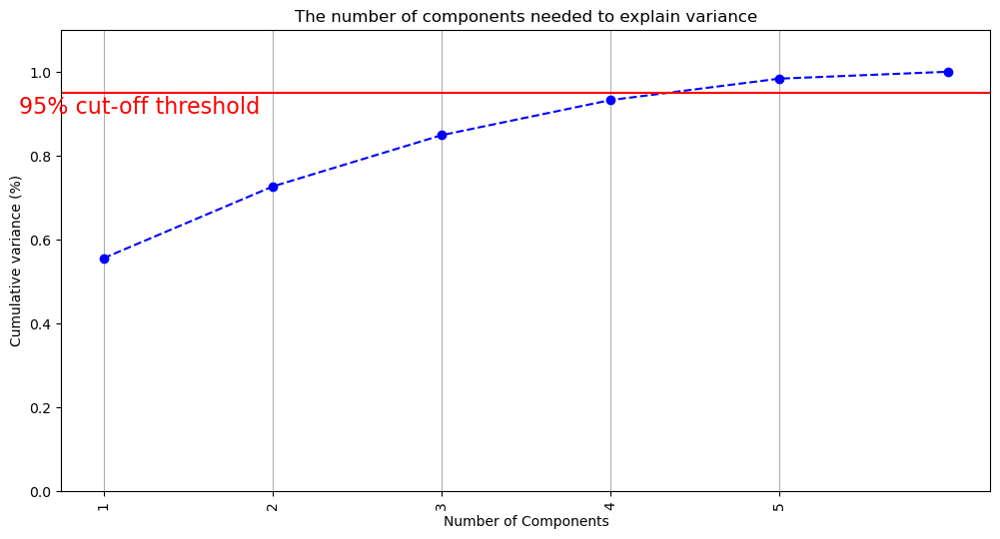

In [160]:
plt.rcParams["figure.figsize"] = (12, 6)

fig, ax = plt.subplots()
xi = np.arange(1, len(df_columns_share) + 1, step=1)
y = np.cumsum(pca.explained_variance_ratio_)

plt.ylim(0.0, 1.1)
plt.plot(xi, y, marker="o", linestyle="--", color="b")

plt.xlabel("Number of Components")
plt.xticks(
    np.arange(1, len(df_columns_share), step=1)
)  # change from 0-based array index to 1-based human-readable label
plt.ylabel("Cumulative variance (%)")
plt.title("The number of components needed to explain variance")

plt.axhline(y=0.95, color="r", linestyle="-")
plt.text(0.5, 0.9, "95% cut-off threshold", color="red", fontsize=16)
plt.xticks(rotation="vertical")
ax.grid(axis="x")
plt.show()

In [161]:
pca_num = 4


In [162]:
pca = PCA(n_components=pca_num)
df_tf_pca = pca.fit_transform(data_pca)

In [202]:
df_tf_pca.shape

(472515, 4)

In [163]:
from clustergram import Clustergram

In [164]:
cg_form = Clustergram(range(1, 10), backend="sklearn", n_init=10)
cg_form.fit(df_tf_pca)

K=1 skipped. Mean computed from data directly.
K=2 fitted in 0.373 seconds.
K=3 fitted in 0.680 seconds.
K=4 fitted in 1.241 seconds.
K=5 fitted in 1.350 seconds.
K=6 fitted in 1.823 seconds.
K=7 fitted in 1.809 seconds.
K=8 fitted in 1.698 seconds.
K=9 fitted in 2.149 seconds.


Clustergram(k_range=range(1, 10), backend='sklearn', method='kmeans', kwargs={'n_init': 10})

(-10.0, 20.0)

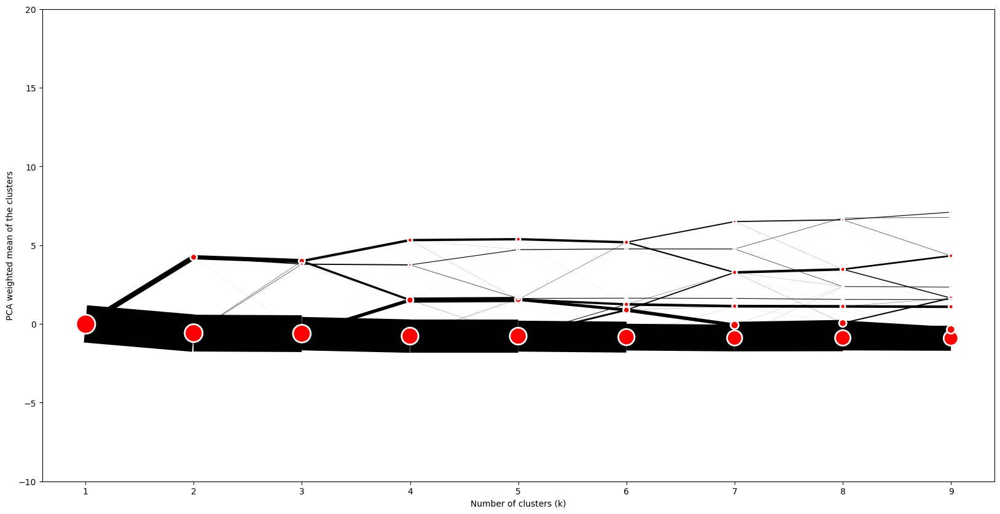

In [165]:
ax = cg_form.plot(figsize=(20, 10))
ax.set_ylim(-10, 20)

In [166]:
from sklearn.metrics import calinski_harabasz_score as chs

In [167]:
values = []
for i in range(2, 10):
    values.append(chs(df_tf_pca, cg_form.labels[i].values))

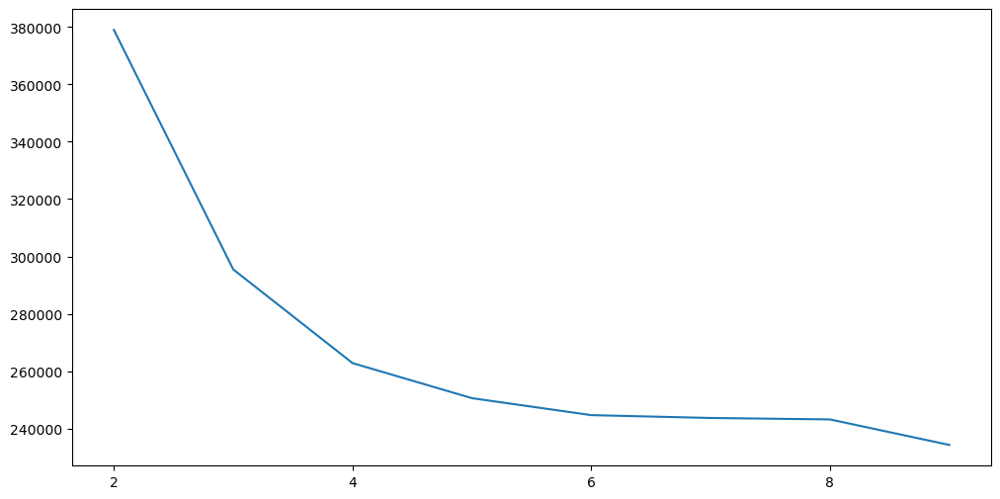

In [168]:
plt.plot(range(2, 10), values)
plt.xticks(range(2, 10, 2));

In [169]:
cluster_form4 = (
    pd.Series(cg_form.labels[4].values, index=data_pca.index)
    .rename("kmeans_cluster_4")
    .to_frame()
)

In [170]:
cluster_form6 = (
    pd.Series(cg_form.labels[6].values, index=data_pca.index)
    .rename("kmeans_cluster_6")
    .to_frame()
)

In [172]:
data_pca = data_pca.join(cluster_form4 )
data_pca = data_pca.join(cluster_form6 )

In [173]:
data_pca.columns

Index(['share_night_hours_duration_in_geohash',
       'share_geohash_duration_in_night_hours', 'share_dwells',
       'share_work_hours_duration_in_geohash',
       'share_geohash_duration_in_work_hours', 'geohash_share_in_weekends',
       'kmeans_cluster_4', 'kmeans_cluster_6'],
      dtype='object')

In [174]:
import matplotlib.cm as cm

<Figure size 1000x600 with 0 Axes>

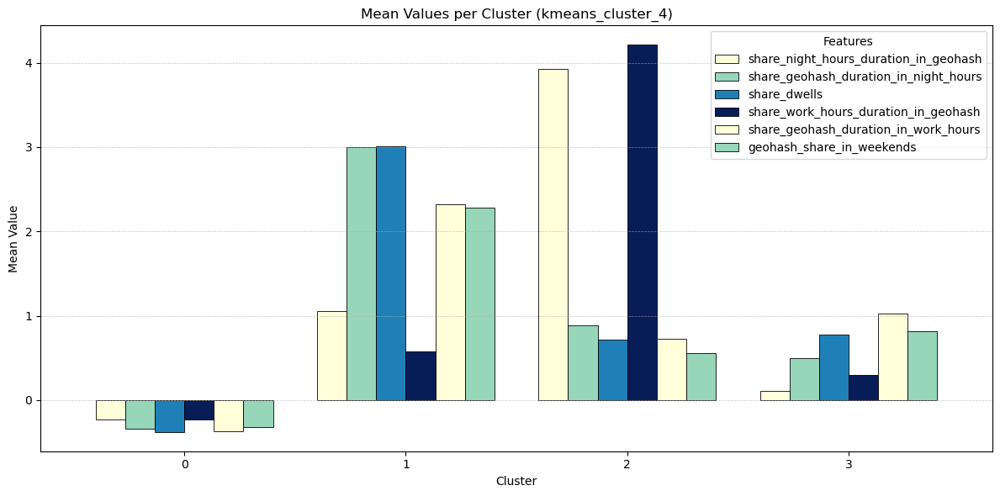

In [175]:
data_to_plot = data_pca.drop('kmeans_cluster_6', axis=1).groupby("kmeans_cluster_4").mean()

# Plot settings
plt.figure(figsize=(10, 6))

# Use a colormap (e.g., 'viridis') for smooth color transition
num_clusters = len(data_to_plot)
colors = cm.YlGnBu(np.linspace(0, 1, num_clusters))

# Create a bar plot with smooth colors
data_to_plot.plot(kind="bar", color=colors, edgecolor='black', linewidth=0.6, width=0.8)

# Enhance the plot aesthetics
plt.title("Mean Values per Cluster (kmeans_cluster_4)")
plt.xlabel("Cluster")
plt.ylabel("Mean Value")
plt.xticks(rotation=0)  # Make sure x-ticks are readable
plt.legend(title="Features")
plt.grid(axis='y', linestyle='--', linewidth=0.5, alpha=0.7)

# Display the plot
plt.tight_layout()
plt.show()

<Figure size 1000x600 with 0 Axes>

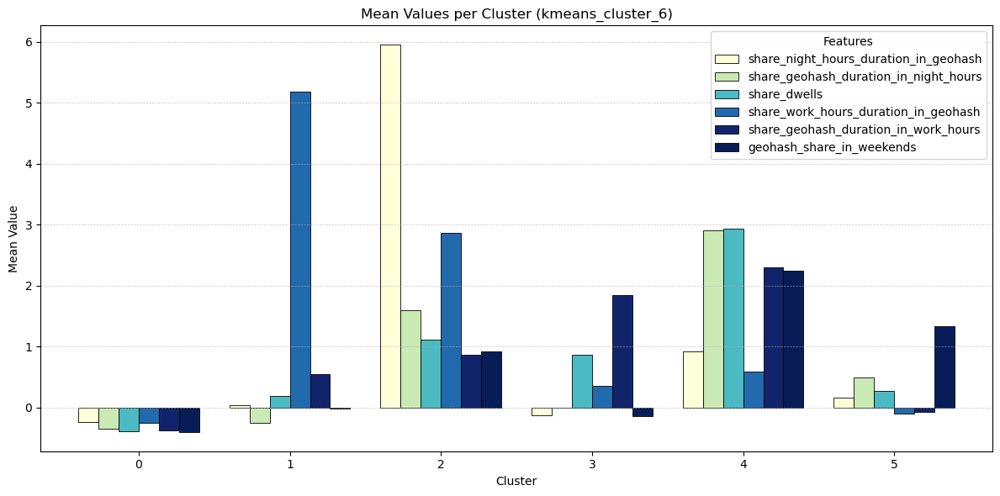

In [176]:
data_to_plot = data_pca.drop('kmeans_cluster_4', axis=1).groupby("kmeans_cluster_6").mean()

# Plot settings
plt.figure(figsize=(10, 6))

# Use a colormap (e.g., 'viridis') for smooth color transition
num_clusters = len(data_to_plot)
colors = cm.YlGnBu(np.linspace(0, 1.2, num_clusters))

# Create a bar plot with smooth colors
data_to_plot.plot(kind="bar", color=colors, edgecolor='black', linewidth=0.6, width=0.8)

# Enhance the plot aesthetics
plt.title("Mean Values per Cluster (kmeans_cluster_6)")
plt.xlabel("Cluster")
plt.ylabel("Mean Value")
plt.xticks(rotation=0)  # Make sure x-ticks are readable
plt.legend(title="Features")
plt.grid(axis='y', linestyle='--', linewidth=0.5, alpha=0.7)

# Display the plot
plt.tight_layout()
plt.show()

In [201]:
len(geohash_identifier_stat_clean)

472515

In [177]:
geohash_identifier_stat_clean["kmeans_cluster_6"]  = cluster_form6
geohash_identifier_stat_clean["kmeans_cluster_4"]  = cluster_form4

In [178]:
geohash_identifier_stat_clean["kmeans_cluster_6"] .value_counts()

kmeans_cluster_6
0    343418
5     52674
3     31793
4     28608
2      8759
1      7263
Name: count, dtype: int64

* 0 - noise
* 1 - work
* 2 - home with presence in work hours ( Bnei brak is there)
* 3 - work
* 4 - work+ home?
* 5 - home  

In [195]:
home_clusters = [2,4,5]
work_clusters=[1,3]

In [196]:
geohash_identifier_stat_clean[geohash_identifier_stat_clean["kmeans_cluster_6"].isin(home_clusters)].shape

(90041, 21)

In [187]:
geohash_identifier_stat_clean[geohash_identifier_stat_clean["kmeans_cluster_6"].isin(work_clusters)].shape

(39056, 21)

In [192]:

geohash_identifier_stat_clean[geohash_identifier_stat_clean["kmeans_cluster_6"].isin(home_clusters)].reset_index().identifier.nunique()

53469

In [190]:
geohash_identifier_stat_clean[geohash_identifier_stat_clean["kmeans_cluster_6"].isin(work_clusters)].reset_index().identifier.nunique()

31611

### We stop at 6

### Making pipeline

In [197]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

pipeline_clusters = Pipeline([
    ('scaler', StandardScaler()),  # Step 1: Standardize the features
    ('pca', PCA(n_components=4)),  # Step 2: Apply PCA with 4 components
    ('kmeans', KMeans(n_clusters=6, n_init=10, random_state=0))  # Step 3: Cluster with KMeans
])

In [203]:
pipeline_clusters.fit(geohash_identifier_stat_clean[df_columns_share])

Pipeline(steps=[('scaler', StandardScaler()), ('pca', PCA(n_components=4)),
                ('kmeans', KMeans(n_clusters=6, n_init=10, random_state=0))])

In [208]:
pipeline_clusters.named_steps['kmeans'].cluster_centers_ = cg_form.cluster_centers_[6]
pipeline_clusters.named_steps['kmeans'].labels_ =cg_form.labels_[6]

In [209]:
geohash_identifier_stat_clean["kmean_pipeline"] = pipeline_clusters.predict(geohash_identifier_stat_clean[df_columns_share])

In [214]:
geohash_identifier_stat_clean[['kmeans_cluster_6','kmean_pipeline']].corr()

,kmeans_cluster_6,kmean_pipeline
kmeans_cluster_6,1.0,1.0
kmean_pipeline,1.0,1.0


In [218]:
import pickle


# Save the KMeans model for k=6 to a pickle file
with open("kmeans_pipeline_202001.pkl", "wb") as file:
    pickle.dump(pipeline_clusters, file)

#### Recovery point

In [106]:
with open("kmeans_k6_model.pkl", "rb") as file:
    kmeans_k6 = pickle.load(file)


In [770]:
# data_pca[["kmeans_cluster_4",'share_geohash_night_hours','count_night_dwells','share_geohash_work_hours','count_work_dwells','count_unique_weekends']].groupby("kmeans_cluster_4").median().plot(kind="bar")

In [116]:
geohash_identifier_stat_clean.shape

(882909, 14)

In [517]:
geohash_identifier_stat_clean["kmeans_cluster_6"].value_counts()

kmeans_cluster_6
3    158510
0     40561
1     37772
4      5932
5      5215
2      3313
Name: count, dtype: int64

ERROR! Session/line number was not unique in database. History logging moved to new session 2


In [220]:
geohash_identifier_stat_clean.groupby("kmeans_cluster_6")[data_pca.columns].mean()

,share_night_hours_duration_in_geohash,share_geohash_duration_in_night_hours,share_dwells,share_work_hours_duration_in_geohash,share_geohash_duration_in_work_hours,geohash_share_in_weekends,kmeans_cluster_4,kmeans_cluster_6
kmeans_cluster_6,,,,,,,,
0,0.006608,0.015547,0.036037,0.013197,0.030475,0.073964,0.002886,0.0
1,0.040704,0.039468,0.116564,0.667368,0.202507,0.172203,1.890403,1.0
2,0.786262,0.483388,0.244109,0.388461,0.261954,0.418615,1.910720,2.0
3,0.020844,0.098013,0.210251,0.085569,0.444802,0.142670,2.507030,3.0
4,0.153293,0.798281,0.496553,0.113648,0.528886,0.762595,1.151531,4.0
5,0.057045,0.218087,0.127458,0.031522,0.088605,0.525669,1.774215,5.0


In [800]:
# geohash_identifier_stat_clean = geohash_identifier_stat_clean.merge(df_geohash_stat,on="geohash",how='left')

In [233]:
stat_geohash = pd.pivot_table(geohash_identifier_stat_clean
                              , index ="geohash"
                              , columns="kmeans_cluster_6"
                              , values = "share_dwells",aggfunc='size')

In [228]:
# stat_clusters = pd.pivot_table(geohash_identifier_stat_clean, index ="YISHUV_STAT_2022", columns="kmeans_cluster_6", values = "rank_home",aggfunc='size')

In [234]:
stat_geohash["max_cluster"]= stat_geohash.iloc[:,1:].idxmax( axis=1)

/var/folders/5p/s8yf3c6n5_1_qnj_m1bgc7x80000gn/T/ipykernel_86881/1476288151.py:1: FutureWarning: The behavior of DataFrame.idxmax with all-NA values, or any-NA and skipna=False, is deprecated. In a future version this will raise ValueError
  stat_geohash["max_cluster"]= stat_geohash.iloc[:,1:].idxmax( axis=1)


In [235]:
stat_geohash["max_cluster"].value_counts()

max_cluster
5.0    6528
1.0    6091
2.0    5021
4.0    3329
3.0    2993
Name: count, dtype: int64

In [236]:
stat_geohash["max_cluster"] = stat_geohash["max_cluster"].fillna(0)

In [240]:
from shapely.geometry import Polygon
import pygeohash
def geohash_to_polygon(geohash):
    # Decode the geohash to get the bounding box
    lon, lat, lon_err, lat_err = pygeohash.decode_exactly(geohash)
    
    # Calculate the bounding box corners
    lat_min = lat - lat_err
    lat_max = lat + lat_err
    lon_min = lon - lon_err
    lon_max = lon + lon_err
    
    # Define the coordinates for the polygon using the bounding box corners
    coordinates = [
        (lon_min, lat_min),  # Bottom-left
        (lon_min, lat_max),  # Top-left
        (lon_max, lat_max),  # Top-right
        (lon_max, lat_min),  # Bottom-right
        (lon_min, lat_min)   # Close the polygon
    ]
    
    # Create a polygon from these coordinates
    polygon = Polygon(coordinates)
    return polygon

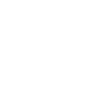

In [241]:
geohash_to_polygon("swnt5nt")

In [242]:
stat_geohash = stat_geohash.reset_index()

In [243]:
stat_geohash["geometry"] = pd.Series(stat_geohash.geohash.apply(lambda x: geohash_to_polygon(x)),
                                     index = stat_geohash.index )

In [244]:
stat_geohash["geometry"]

0        POLYGON ((34.66461181640625 31.78070068359375,...
1        POLYGON ((34.665985107421875 31.78070068359375...
2        POLYGON ((34.668731689453125 31.78070068359375...
3        POLYGON ((34.67010498046875 31.78070068359375,...
4        POLYGON ((34.665985107421875 31.78482055664062...
                               ...                        
26096    POLYGON ((35.02716064453125 32.361602783203125...
26097    POLYGON ((35.02716064453125 32.36297607421875,...
26098    POLYGON ((35.02716064453125 32.364349365234375...
26099    POLYGON ((35.028533935546875 32.36572265625, 3...
26100    POLYGON ((35.028533935546875 32.36846923828125...
Name: geometry, Length: 26101, dtype: object

In [813]:
# stat_clusters = stat_clusters.merge(stat_areas, on = "YISHUV_STAT_2022")

In [296]:
stat_2carto = gpd.GeoDataFrame(stat_geohash.rename(columns={"geometry":"the_geom"}),geometry="the_geom", crs=4326)

In [297]:
"cluster_"+stat_2carto.columns[2:8].astype(str)

Index(['cluster_0', 'cluster_1', 'cluster_2', 'cluster_3', 'cluster_4',
       'cluster_5'],
      dtype='object', name='kmeans_cluster_6')

In [299]:
stat_2carto = stat_2carto.rename(columns = dict(zip(stat_2carto.columns[2:8],"cluster_"+stat_2carto.columns[2:8].astype(str))))

In [300]:
stat_2carto = stat_2carto.fillna(0)

In [295]:
stat_2carto.head()

kmeans_cluster_6,index,geohash,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,max_cluster,the_geom
0,0,swnt5nw,0.0,0.0,1.0,0.0,0.0,0.0,2.0,"POLYGON ((34.66461 31.7807, 34.66461 31.78207,..."
1,1,swnt5ny,2.0,0.0,0.0,0.0,0.0,0.0,0.0,"POLYGON ((34.66599 31.7807, 34.66599 31.78207,..."
2,2,swnt5pq,1.0,0.0,0.0,0.0,0.0,0.0,0.0,"POLYGON ((34.66873 31.7807, 34.66873 31.78207,..."
3,3,swnt5pw,2.0,0.0,0.0,0.0,0.0,0.0,0.0,"POLYGON ((34.6701 31.7807, 34.6701 31.78207, 3..."
4,4,swnt5qc,0.0,0.0,1.0,0.0,0.0,0.0,2.0,"POLYGON ((34.66599 31.78482, 34.66599 31.78619..."


In [ ]:
stat_2carto.drop("index", axis=1).to_file(utils.get_path('processed','dwells',"geohash_clusters_202001.geojson"))

### Number geohashes visited by user 

In [255]:
user_clusters = geohash_identifier_stat_clean.reset_index().pivot_table(index = "identifier"
                                                        , columns = "kmeans_cluster_6"
                                                        , values = "geohash"
                                                        , aggfunc='size'
                                                       ).fillna(0)

In [256]:
user_clusters.columns = "cluster_"+user_clusters.columns.astype(str)

In [289]:
home_clusters = ["cluster_2","cluster_5"]
work_clusters=["cluster_1","cluster_3","cluster_4"]

In [280]:
user_clusters

kmeans_cluster_6,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5
identifier,,,,,,
0000be11-1c2a-4833-8f5e-d49f25b5fde9,2.0,0.0,0.0,0.0,0.0,3.0
00011a0e-9b5f-4de2-9d1e-147f2b85831e,3.0,0.0,0.0,1.0,0.0,1.0
00065be3-e477-417b-b498-51b1e0154e6c,2.0,0.0,0.0,0.0,1.0,0.0
00081fd0-add3-4519-b861-ddfef04fe026,9.0,0.0,0.0,1.0,0.0,1.0
0008481c-a961-48b2-a596-11d45ef53ad7,1.0,0.0,0.0,0.0,1.0,1.0
...,...,...,...,...,...,...
fffe150d-f747-4e4c-883b-efb11ceca235,9.0,0.0,0.0,0.0,1.0,1.0
fffe35a5-5939-4281-a59a-fc021fac9744,3.0,0.0,0.0,1.0,0.0,1.0
fffef5b8-1ce9-42f9-9c82-f0c71eea1a51,15.0,0.0,0.0,0.0,0.0,1.0


### This means that for significant number of user we are capable of finding home

In [290]:
user_clusters[home_clusters].sum(axis=1).value_counts()

0.0     20014
1.0     18989
2.0     11329
3.0      4172
4.0      1203
5.0       321
6.0        84
7.0        24
8.0        10
9.0         4
10.0        3
11.0        2
13.0        1
Name: count, dtype: int64

Cluster 5 is home when other home clusters are absent

In [285]:
user_clusters[user_clusters[home_clusters].sum(axis=1)>1]

kmeans_cluster_6,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5
identifier,,,,,,
0000be11-1c2a-4833-8f5e-d49f25b5fde9,2.0,0.0,0.0,0.0,0.0,3.0
0008481c-a961-48b2-a596-11d45ef53ad7,1.0,0.0,0.0,0.0,1.0,1.0
00092738-9ce5-45f7-b012-bdc70063e582,5.0,0.0,0.0,0.0,1.0,1.0
000a443a-8fa1-4521-a290-d20f24cb1410,21.0,0.0,3.0,0.0,0.0,0.0
000b20d3-eeb6-4449-8480-4dcabd2a2d32,9.0,0.0,0.0,0.0,1.0,3.0
...,...,...,...,...,...,...
fff4feac-db15-4cbb-99b4-5b0c74a4e568,12.0,1.0,0.0,0.0,0.0,3.0
fff8650f-0ad8-4014-a901-06e5da350cb8,9.0,0.0,0.0,0.0,1.0,1.0
fffa3cb1-de52-4823-a48f-e8bce83c5a18,9.0,0.0,0.0,1.0,0.0,3.0


In [275]:
user_clusters[work_clusters].sum(axis=1).value_counts()

1.0     25306
0.0     24545
2.0      5546
3.0       561
4.0       122
5.0        33
6.0        21
7.0         9
8.0         5
11.0        3
10.0        2
18.0        1
9.0         1
13.0        1
Name: count, dtype: int64

<Axes: >

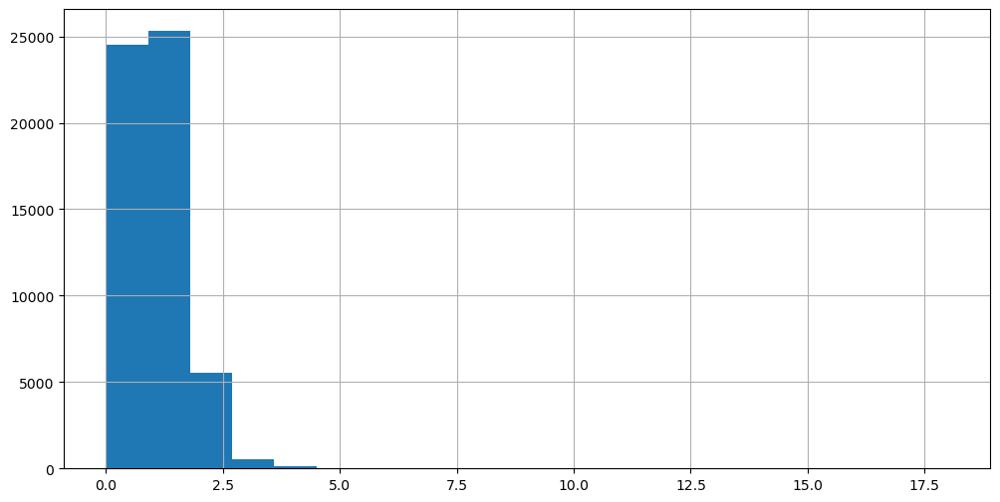

In [263]:
user_clusters[work_clusters].sum(axis=1).hist(bins=20)

### Now lets explore how clusters match with signals on map. We have specifically focus on those who have identical clusters for different geohashes

In [276]:
df_filtered_dwells_geohash_geom = df_filtered_dwells.merge(geohash_identifier_stat_clean[["kmeans_cluster_6"]],  on = ['geohash','identifier'])

In [281]:
geohash_identifier_stat_clean.loc['0008481c-a961-48b2-a596-11d45ef53ad7'  ]

,share_geohash_in_night_hours,share_night_hours_in_geohash,rank,share_night_hours_duration_in_geohash,share_geohash_duration_in_night_hours,count_night_dwells,duration_seconds_home,total_count_dwells,total_duration_seconds,count_days,...,share_work_hours_in_geohash,share_work_hours_duration_in_geohash,share_geohash_duration_in_work_hours,count_work_dwells,duration_seconds_work,geohash_share_in_weekends,count_unique_weekends,kmeans_cluster_6,kmeans_cluster_4,kmean_pipeline
geohash,,,,,,,,,,,,,,,,,,,,,
swntzg6,0.000000,0.000000,6.5,0.000000,0.000000,0,0.0,3,1809.0,3,...,0.031250,0.003889,0.009648,2,1065.0,0.2,1.0,0,0,0
swntzgd,0.333333,0.017241,2.0,0.007704,0.132282,1,2986.0,25,90830.0,17,...,0.123457,0.087403,0.720881,20,79578.0,0.4,2.0,4,1,4
swntzv9,0.666667,0.117647,1.0,0.224879,0.867718,2,19587.0,5,39681.0,4,...,0.015504,0.038381,0.206368,2,22781.0,0.4,2.0,5,3,5


In [183]:
# df_filtered_dwells_geohash_geom = df_filtered_dwells.merge(stat_geohash[['geohash',"geometry"]],on='geohash', how='inner')

In [548]:
df_filtered_dwells_geohash_geom.columns

Index(['identifier', 'identifier_type', 'timestamp', 'local_date_time',
       'province', 'classification', 'duration_seconds', 'centroid_latitude',
       'centroid_longitude', 'bump_count', 'potential_start_time',
       'potential_end_time', 'month', 'the_geom', 'frequency',
       'long_3precision', 'lat_3precision', 'date', 'flag_night',
       'flag_weekday_day', 'geohash', 'start_date_time', 'end_date_time',
       'hour', 'potenital_duration_seconds', 'flag_work_hours',
       'duration_hours', 'weekday_number', 'flag_weekend', 'kmeans_cluster_6'],
      dtype='object')

In [284]:
df_filtered_dwells_geohash_geom [df_filtered_dwells_geohash_geom ["identifier"]=='0008481c-a961-48b2-a596-11d45ef53ad7'][["the_geom","geohash","kmeans_cluster_6","flag_night","flag_work_hours","local_date_time",'flag_weekend']].explore(column='kmeans_cluster_6', categorical=True, tiles="CartoDB positron")

In [288]:
df_filtered_dwells_geohash_geom [df_filtered_dwells_geohash_geom ["identifier"]=='00092738-9ce5-45f7-b012-bdc70063e582'][["the_geom","geohash","kmeans_cluster_6","flag_night","flag_work_hours","local_date_time",'flag_weekend']].explore(column='kmeans_cluster_6', categorical=True, tiles="CartoDB positron")